# Load the LGMR data (mean of the ensemble)

In [1]:
import xarray as xr
# open the 'LGMR_GMST_ens.nc' file
ds_sat = xr.open_dataset('data/LGMR_SAT_climo.nc')
ds_sat.info

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


<bound method Dataset.info of <xarray.Dataset>
Dimensions:  (lat: 96, lon: 144, age: 120)
Coordinates:
  * lat      (lat) float32 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float32 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5
  * age      (age) float32 100.0 300.0 500.0 ... 2.35e+04 2.37e+04 2.39e+04
Data variables:
    sat      (age, lat, lon) float32 ...
    sat_std  (age, lat, lon) float32 ...>

In [18]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import xarray as xr

# Calculate the difference in SAT between the first and last age values
sat_diff = ds_sat['sat'].sel(age=22000,method='nearest') - ds_sat['sat'].sel(age=1000,method='nearest')
# sat_diff = ds_sat['sat'].isel(0) - ds_sat['sat'].isel(-1)

# Plotting
fig = plt.figure(figsize=(12, 6),dpi=1200)
ax = fig.add_subplot(1, 1, 1, projection=ccrs.Robinson())
ax.set_global()
ax.coastlines()

# Plot the difference
sat_diff_plot = ax.pcolormesh(ds_sat['lon'], ds_sat['lat'], sat_diff, transform=ccrs.PlateCarree(), cmap='coolwarm')

# Add a colorbar
cbar = plt.colorbar(sat_diff_plot, orientation='horizontal', pad=0.05, aspect=50, shrink=0.5)
cbar.set_label('Delta SAT (°C)')

# plt.title('LGMR SAT Differences between 22000 and 1000 yr BP')
plt.show()


d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


c:\Users\zps19\.conda\envs\pz-env\lib\site-packages\xarray\coding\variables.py:148: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


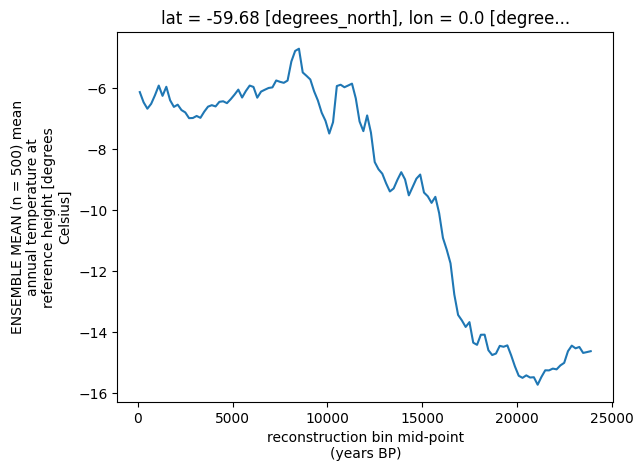

In [5]:
ds_sat['sat'].isel(lat=16,lon=0).plot()

# Crop the data for age>11

In [2]:

# ds_sat = ds_sat.where(ds_sat.age>=11000, drop=True)

ds_sat = ds_sat.where(ds_sat.age>=11000, drop=True)

d:\Users\User\anaconda3\envs\pz_venv_causal\lib\site-packages\xarray\coding\variables.py:147: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


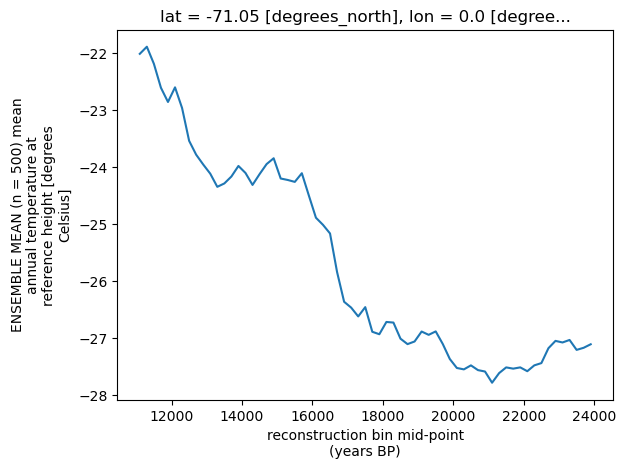

In [3]:
ds_sat['sat'].isel(lat=10).isel(lon=0).plot()

# Center and weight the data

shape of the weight: (96,)
shape of the reshaped sat_centered_weighted: (65, 13824)


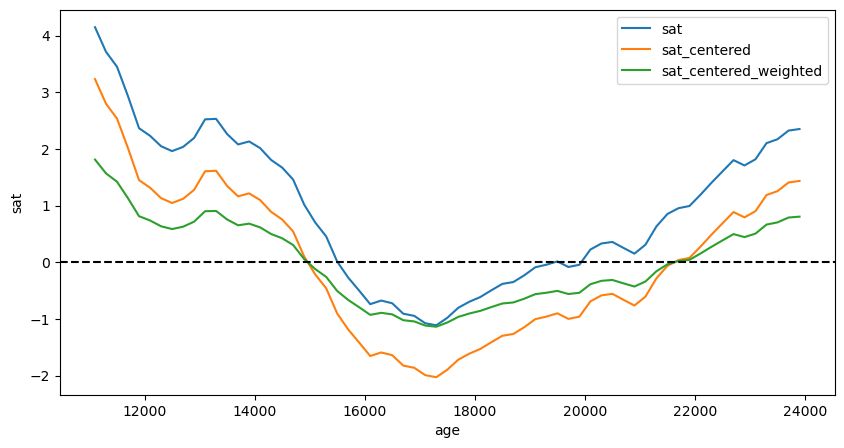

In [4]:
from toolbox import PCA_functions as pf
# 1. Center the Data
ds_sat = pf.center_data(ds_sat)

# 2. Weight the Data
ds_sat = pf.apply_weighting(ds_sat)

# 3. Plot the Centered and Weighted Data
lat_index = 77
lon_index = 90
pf.plot_sat_variables(ds_sat, lat_index, lon_index)


# PCA

In [5]:
from toolbox import PCA_functions as pf
import importlib
importlib.reload(pf)
# 4. Perform PCA
exp_v_climo, eofs_climo, pcs_climo = pf.sat_PCA(ds_sat)
print('Explained variance:', exp_v_climo)

shape of the reshaped sat_centered_weighted: (13824, 65)
shape of u, s, vh: (13824, 13824) (65,) (65, 65)
shape of EOFs: (13824, 2)
shape of PCs: (65, 2)
Explained variance: [8.98258686e-01 8.04840028e-02 7.40235392e-03 5.19952085e-03
 2.63320236e-03 2.17852276e-03 1.61866844e-03 7.41521362e-04
 3.43156047e-04 2.67069583e-04 2.14783169e-04 1.25641935e-04
 1.05506122e-04 8.99674415e-05 6.97138094e-05 5.73843863e-05
 4.11159162e-05 2.85841179e-05 2.40365462e-05 2.04937060e-05
 1.56445531e-05 1.33408384e-05 1.00197658e-05 9.03837099e-06
 8.46516286e-06 6.73880777e-06 5.06810420e-06 4.94178948e-06
 3.91775711e-06 3.26156487e-06 2.69328530e-06 2.56359567e-06
 1.72111925e-06 1.29166426e-06 1.08624761e-06 7.33775494e-07
 6.68961661e-07 6.38538950e-07 5.43628573e-07 4.89633464e-07
 4.49905457e-07 3.24484660e-07 2.99716788e-07 2.64120160e-07
 2.16782738e-07 1.99238471e-07 1.74655526e-07 1.58337343e-07
 1.42285387e-07 1.23404902e-07 1.21093862e-07 9.92318832e-08
 9.25580537e-08 7.17794606e-08 6.

# Plot PCA result

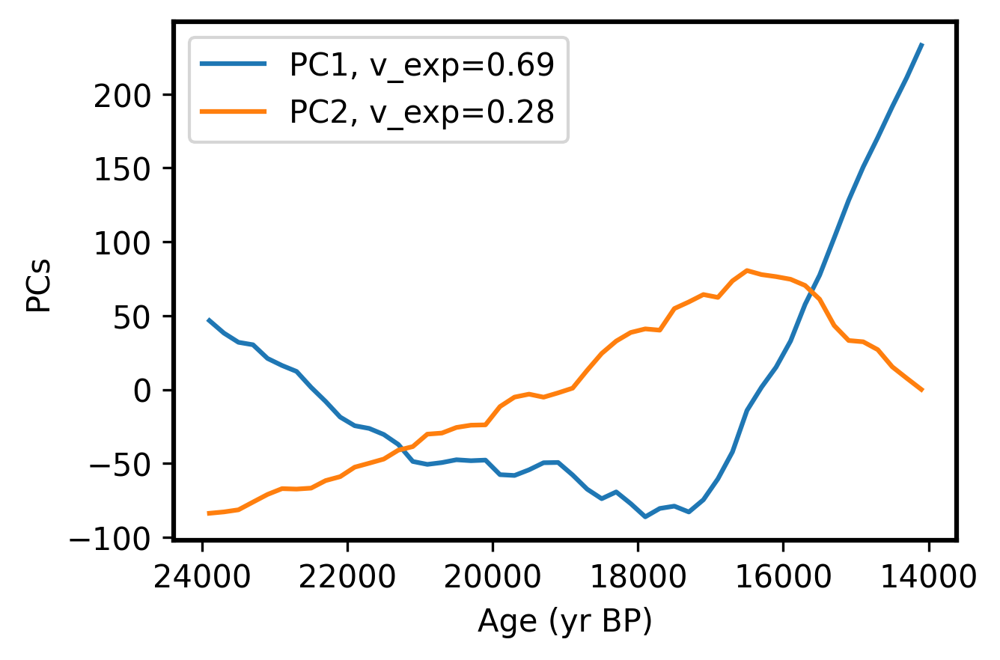

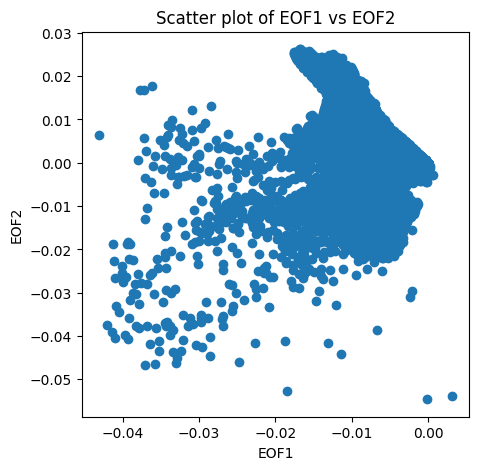

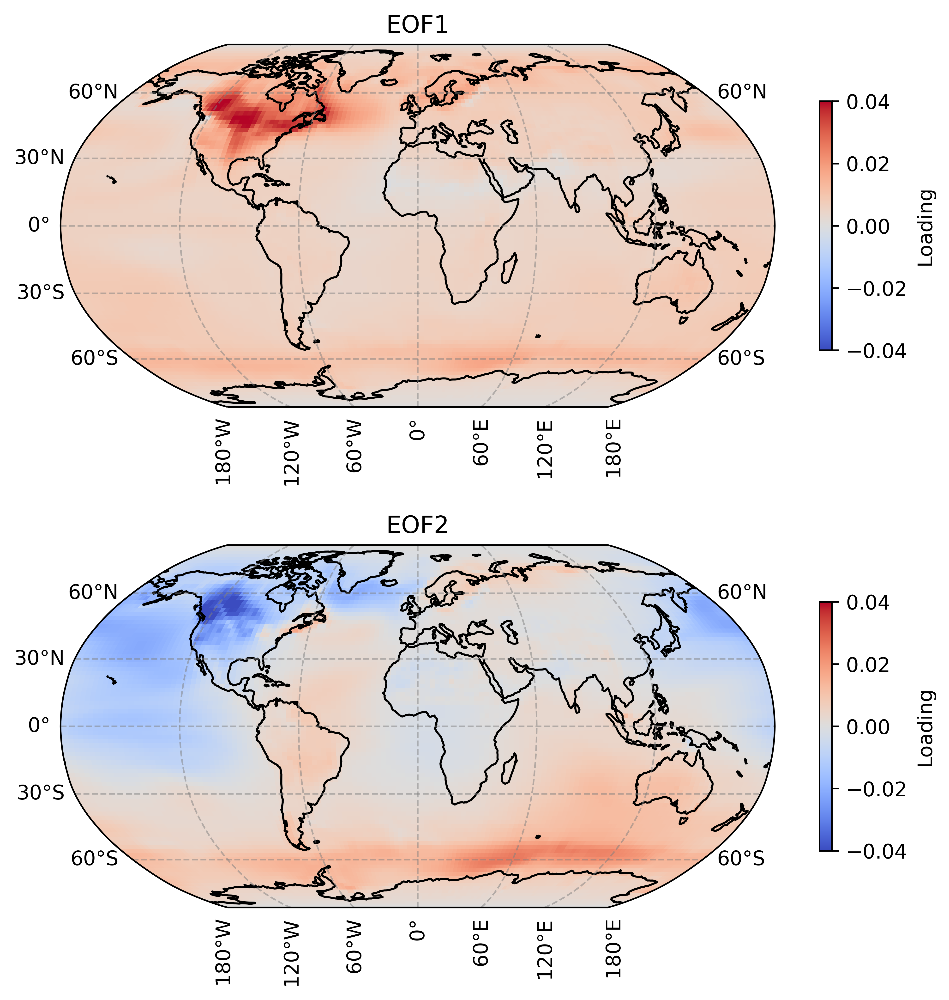

In [37]:
from toolbox import PCA_functions as pf
import importlib
importlib.reload(pf)

# 5. Plot pcs_climo
fig_pc,ax=pf.plot_pcs(ds_sat['age'].values, pcs_climo, exp_v_climo)

# 6. Plot EOF Scatter
pf.plot_eof_scatter(eofs_climo)

# 7. Plot the EOF Map
fig_eof,axs=pf.plot_eof_map(eofs_climo, ds_sat['lat'].values, ds_sat['lon'].values)

# Save figure

In [ ]:
output_path = 'D:/VScode/Last_deglaciation/fig_exp_temp/'
fig_pc.savefig(output_path+'/PC_crop_at_14.svg', format='svg', dpi=600,bbox_inches='tight')

In [46]:
output_path = 'D:/VScode/Last_deglaciation/fig_exp_temp/'
fig_eof.savefig(output_path+'/LGMR_mean_eof.svg', format='svg', dpi=600,bbox_inches='tight')

# Save the exp_v, eofs_climo and pcs_climo

In [7]:
# save exp_v_climo, eofs_climo, pcs
import pickle
pickle.dump(exp_v_climo, open('climo_ana_data/exp_v_climo.pkl', 'wb'))
pickle.dump(eofs_climo, open('climo_ana_data/eofs_climo.pkl', 'wb'))
pickle.dump(pcs_climo, open('climo_ana_data/pcs_climo.pkl', 'wb'))

In [3]:
# load exp_v_climo, eofs_climo, pcs
import pickle
exp_v_climo = pickle.load(open('climo_ana_data/exp_v_climo.pkl', 'rb'))
eofs_climo = pickle.load(open('climo_ana_data/eofs_climo.pkl', 'rb'))
pcs_climo = pickle.load(open('climo_ana_data/pcs_climo.pkl', 'rb'))

# PCA, using sklearn

shape of the reshaped sat_centered_weighted: (65, 13824)
shape of PCs: (65, 2)
Explained variance: [0.8982588  0.08048404]
shape of EOFs: (13824, 2)
Explained variance: [0.8982588  0.08048404]


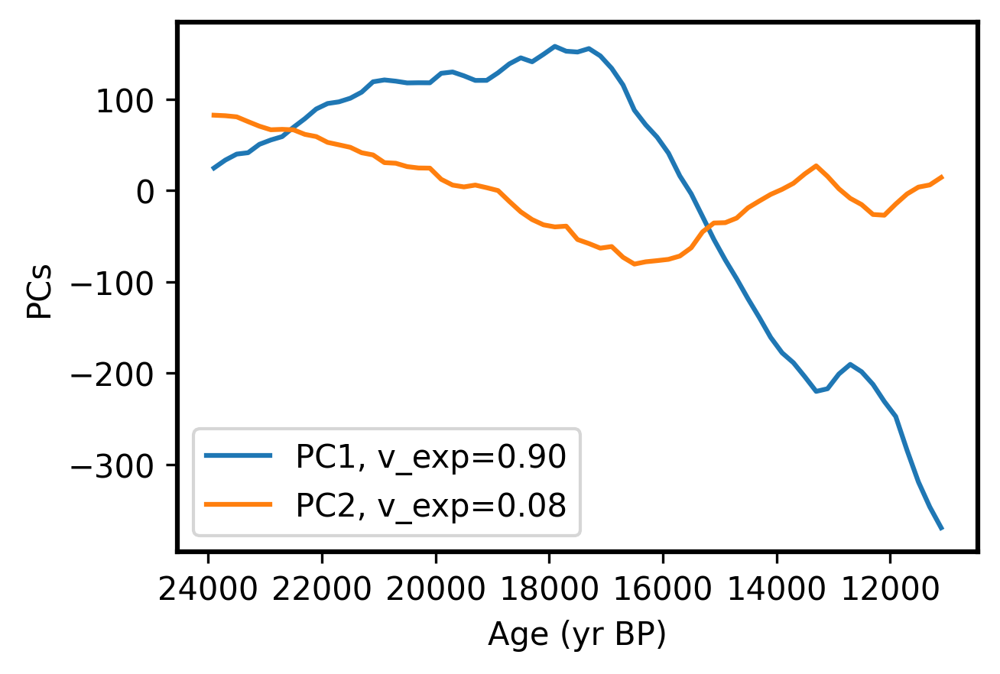

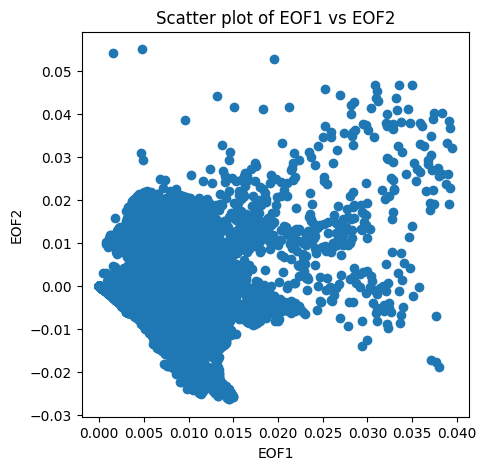

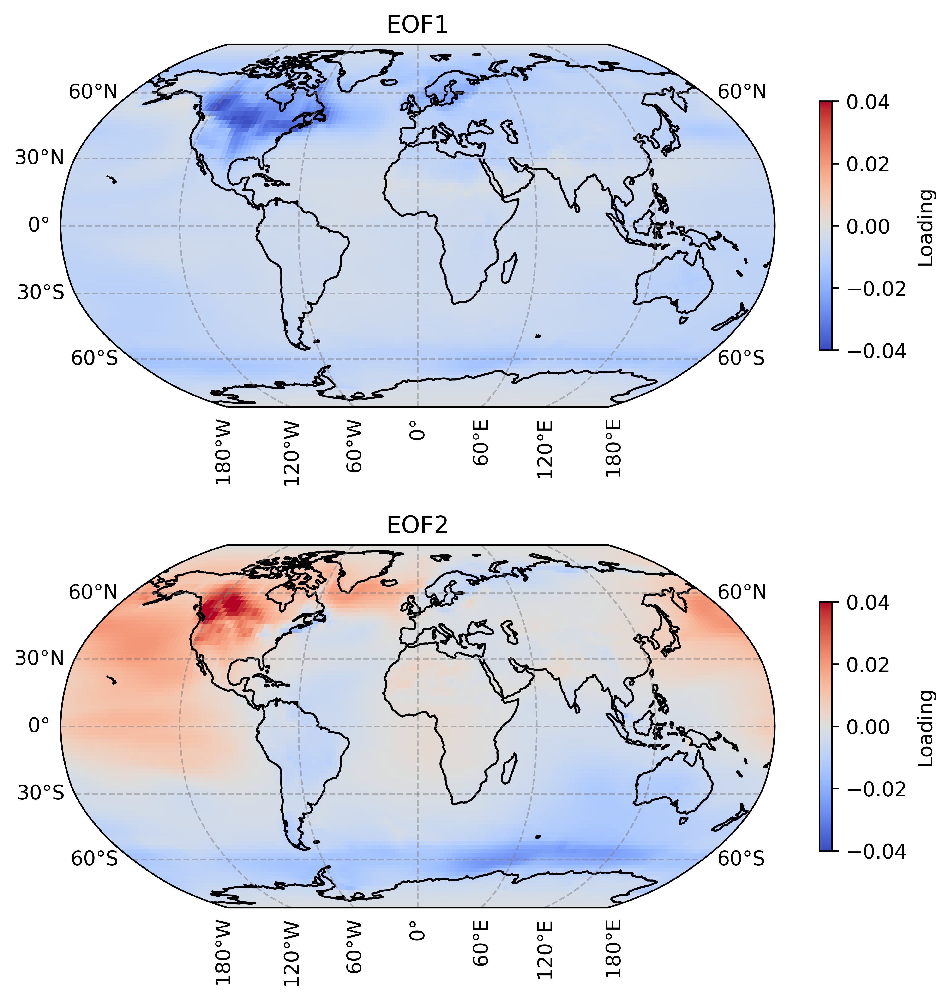

(<Figure size 4800x5400 with 4 Axes>,
 array([<GeoAxesSubplot: title={'center': 'EOF1'}>,
        <GeoAxesSubplot: title={'center': 'EOF2'}>], dtype=object))

In [30]:
from toolbox import PCA_functions as pf
# 4. Perform PCA
exp_v_climo_sk, eofs_climo_sk, pcs_climo_sk = pf.sat_PCA_sklearn(ds_sat)
print('Explained variance:', exp_v_climo_sk)

# Plot PCs
pf.plot_pcs(ds_sat['age'].values, pcs_climo_sk, exp_v_climo_sk)

# 6. Plot EOF Scatter
pf.plot_eof_scatter(eofs_climo_sk)

# 7. Plot the EOF Map
pf.plot_eof_map(eofs_climo_sk, ds_sat['lat'].values, ds_sat['lon'].values)

# Save the data

In [7]:
# save exp_v_climo_sk, eofs_climo_sk, pcs_climo_sk
import pickle
pickle.dump(exp_v_climo_sk, open('climo_ana_data/exp_v_climo_sk.pkl', 'wb'))
pickle.dump(eofs_climo_sk, open('climo_ana_data/eofs_climo_sk.pkl', 'wb'))
pickle.dump(pcs_climo_sk, open('climo_ana_data/pcs_climo_sk.pkl', 'wb'))

In [ ]:
# read exp_v_climo_sk, eofs_climo_sk, pcs_climo_sk
import pickle
exp_v_climo_sk = pickle.load(open('climo_ana_data/exp_v_climo_sk.pkl', 'rb'))
eofs_climo_sk = pickle.load(open('climo_ana_data/eofs_climo_sk.pkl', 'rb'))
pcs_climo_sk = pickle.load(open('climo_ana_data/pcs_climo_sk.pkl', 'rb'))

# GMM

In [12]:
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from scipy.stats import zscore
import numpy as np
from sklearn.mixture import GaussianMixture
import xarray as xr
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

data=eofs_climo

sat_shape=ds_sat['sat'].shape

# create a 2D GMM model
gmm_model = GaussianMixture(n_components=4, covariance_type='full')

# fit the model to the two columns of PCA scores
gmm_model.fit(data)

# get the predicted class labels for each data point
class_labels = gmm_model.predict(data)
probabilities = gmm_model.predict_proba(data)
max_prob = np.amax(probabilities, axis=1)


# new_ds=ds_sat.copy()
# add the class labels to the xarray dataset
ds=ds_sat.copy()
ds['class_label'] = (('lat', 'lon'), class_labels.reshape(sat_shape[1], sat_shape[2]))
reshaped_probs = max_prob.reshape(sat_shape[1], sat_shape[2])


In [8]:
class_labels.shape

(13824,)

In [9]:
probabilities

array([[0.96271599, 0.00208555, 0.02948235, 0.00571611],
       [0.96271599, 0.00208555, 0.02948235, 0.00571611],
       [0.96271599, 0.00208555, 0.02948235, 0.00571611],
       ...,
       [0.96271599, 0.00208555, 0.02948235, 0.00571611],
       [0.96271599, 0.00208555, 0.02948235, 0.00571611],
       [0.96271599, 0.00208555, 0.02948235, 0.00571611]])

In [11]:
# get the highest probability for row in the probabilities array
max_prob = np.amax(probabilities, axis=1)
max_prob.shape

(13824,)

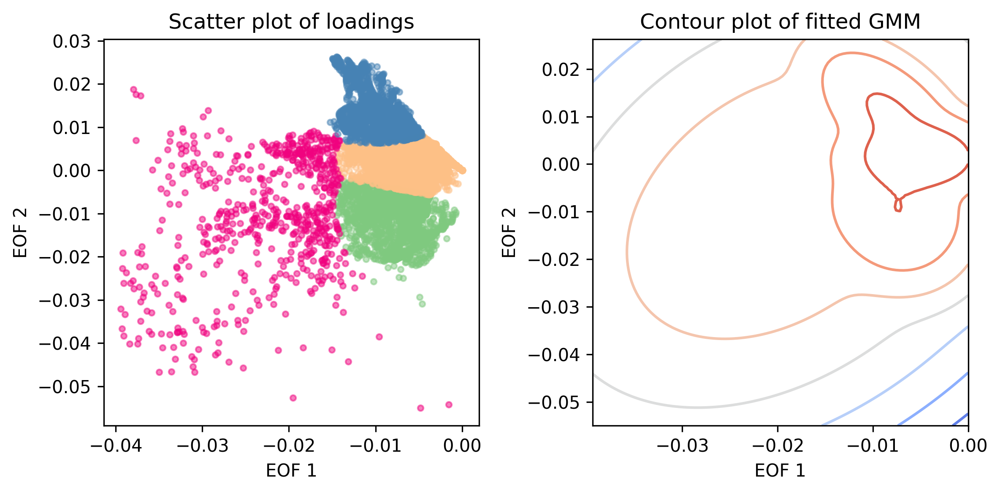

In [23]:
from toolbox import GMM_functions as gf
import importlib
importlib.reload(gf)

ds_GMM_climo,probs=gf.GMM4EOFS(eofs_climo, ds_sat,n_components=4)

# Store the GMM results

In [25]:
# save the ds_EOFs_GMM
ds_GMM_climo.to_netcdf('climo_ana_data/ds_GMM_climo.nc')
# save the probs
import pickle
pickle.dump(probs, open('climo_ana_data/probs.pkl', 'wb'))

In [26]:
# load the ds_EOFs_GMM
import xarray as xr
ds_GMM_climo = xr.open_dataset('climo_ana_data/ds_GMM_climo.nc')
# load the probs
import pickle
probs = pickle.load(open('climo_ana_data/probs.pkl', 'rb'))

# Plot the spatial distribution of labels

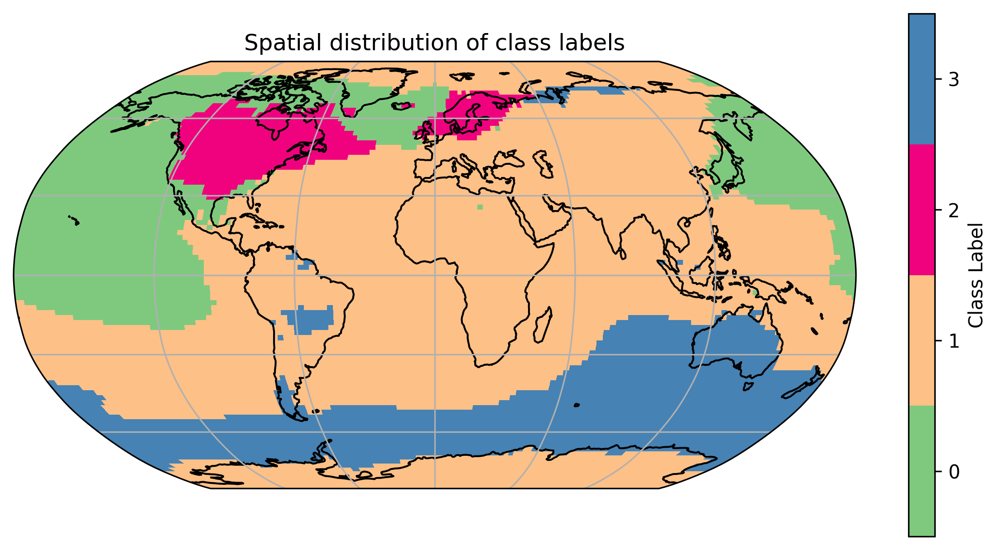

In [12]:
from toolbox import GMM_functions as gf
import importlib
importlib.reload(gf)

gf.plot_labels(ds_GMM_climo)

# Plot the weighted average curves

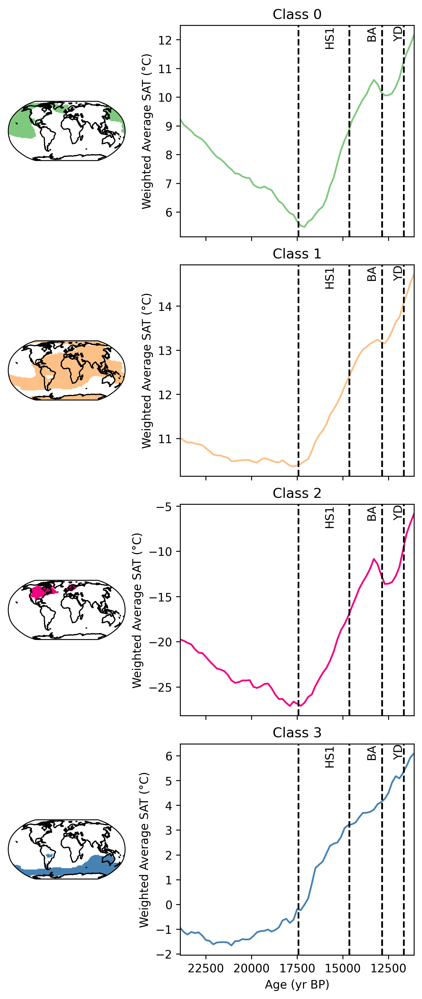

In [13]:
from toolbox import GMM_functions as gf
import importlib
importlib.reload(gf)

uncor_weighted_avg=gf.plot_weighted_average_curve(ds_GMM_climo.copy(), dpi=300)

In [14]:
# store the uncor_weighted_avg
import pickle
pickle.dump(uncor_weighted_avg, open('climo_ana_data/uncor_weighted_avg.pkl', 'wb'))

In [15]:
# load the uncor_weighted_avg
import pickle
uncor_weighted_avg = pickle.load(open('climo_ana_data/uncor_weighted_avg.pkl', 'rb'))

# Find change points

-Progress:100.0% done[==============================================================]
pospr_diff_max_index: 34
cps [16. 23. 34. 40. 48.]
selected_cp_index: 2
\Progress:100.0% done[==============================================================]
pospr_diff_max_index: 34
cps [14. 29. 35. 51.]
selected_cp_index: 2
|Progress:100.0% done[==============================================================]
pospr_diff_max_index: 34
cps [17. 26. 35. 43. 49.]
selected_cp_index: 2
/Progress:100.0% done[==============================================================]
pospr_diff_max_index: 13
cps [15. 28. 32. 37. 45.]
selected_cp_index: 0


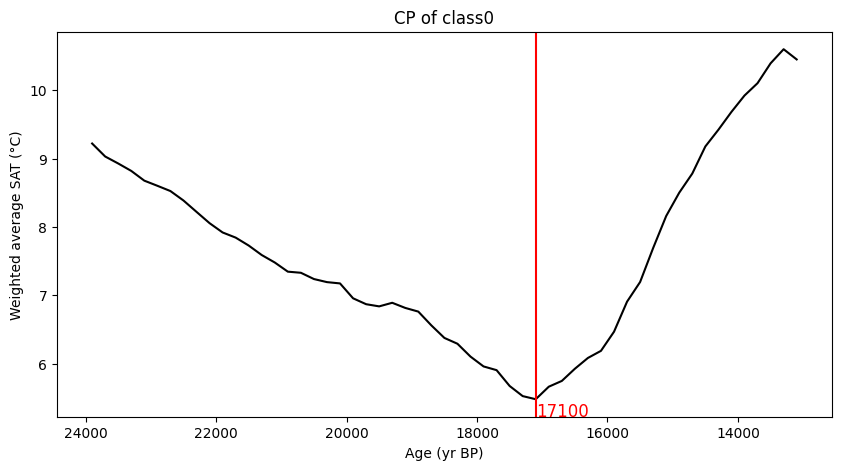

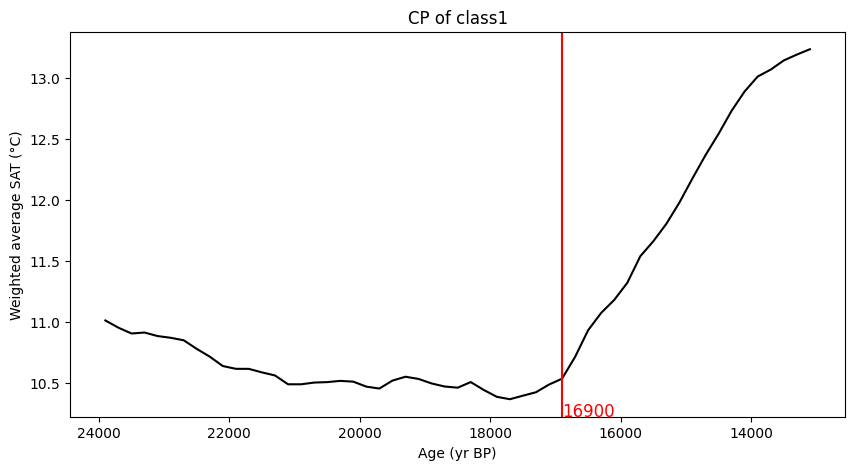

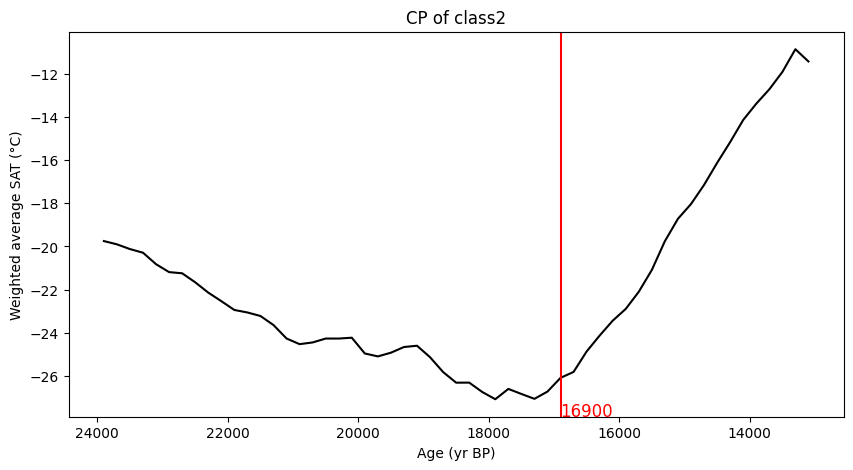

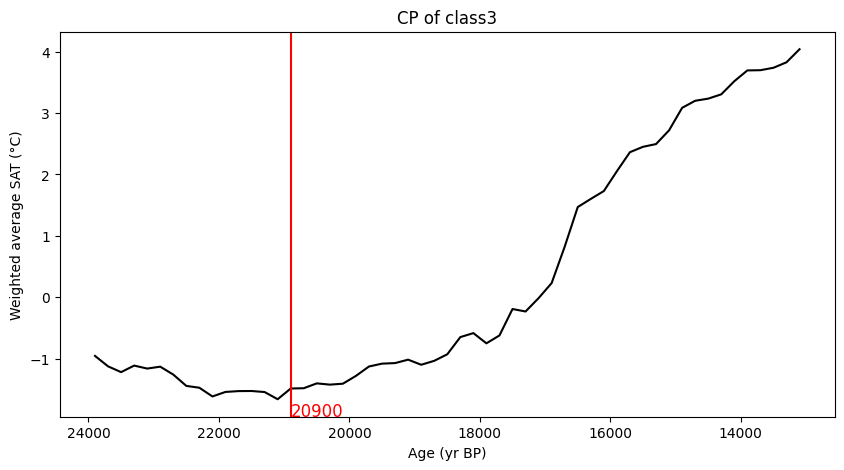

In [16]:
from toolbox import change_point_functions as cpf
unsorted_cp={}
for i in range(len(uncor_weighted_avg)):
    cp_climo_info=cpf.find_cp(uncor_weighted_avg[i], ds_GMM_climo['age'].values, avg_plot=True, avg_plot_title=f'CP of class{i}')
    unsorted_cp[i]=cp_climo_info['cp_age']


# Store the cp_climo_info

In [17]:
# save the 'cp_climo_info'
import pickle
pickle.dump(unsorted_cp, open('climo_ana_data/cp_climo_info.pkl', 'wb'))


In [18]:
# load the cp_climo_info
import pickle
unsorted_cp = pickle.load(open('climo_ana_data/cp_climo_info.pkl', 'rb'))

# Sort the class label according to the cps

In [19]:
from toolbox import change_point_functions as cpf
relabeled_cp, match = cpf.sort_classes_by_cp_age(unsorted_cp)
print("Relabeled Classes:", relabeled_cp)
print("Match Between Unsorted and Sorted Classes:", match)

Relabeled Classes: {0: 20900.0, 1: 17100.0, 2: 16900.0, 3: 16900.0}
Match Between Unsorted and Sorted Classes: {3: 0, 0: 1, 1: 2, 2: 3}


# Relabel the class_label

In [20]:
import numpy as np

ds_GMM_climo_relabeled = ds_GMM_climo.copy()

# Convert the class_label data into a numpy array to work with it directly
original_class_labels = ds_GMM_climo['class_label'].values

# Create a new array for relabeled class labels based on the match dictionary
relabeled_class_labels = np.vectorize(match.get)(original_class_labels)

# Add the new relabeled class labels as a data variable to the dataset
ds_GMM_climo_relabeled['class_relabeled'] = (('lat', 'lon'), relabeled_class_labels)

In [21]:
ds_GMM_climo_relabeled

<xarray.Dataset>
Dimensions:                (age: 65, lat: 96, lon: 144)
Coordinates:
  * lat                    (lat) float32 -90.0 -88.11 -86.21 ... 88.11 90.0
  * lon                    (lon) float32 0.0 2.5 5.0 7.5 ... 352.5 355.0 357.5
  * age                    (age) float32 1.11e+04 1.13e+04 ... 2.37e+04 2.39e+04
Data variables:
    sat                    (age, lat, lon) float32 ...
    sat_std                (age, lat, lon) float32 ...
    sat_centered           (age, lat, lon) float32 ...
    weight                 (lat) float32 ...
    sat_centered_weighted  (age, lat, lon) float32 ...
    class_label            (lat, lon) int64 1 1 1 1 1 1 1 1 ... 1 1 1 1 1 1 1 1
    class_relabeled        (lat, lon) int32 2 2 2 2 2 2 2 2 ... 2 2 2 2 2 2 2 2

In [22]:
# store the ds_GMM_climo_relabeled
ds_GMM_climo_relabeled['lat'].encoding['missing_value'] = np.nan
ds_GMM_climo_relabeled['lon'].encoding['missing_value'] = np.nan
ds_GMM_climo_relabeled.to_netcdf('climo_ana_data/ds_GMM_climo_relabeled.nc')

In [63]:
# load the ds_GMM_climo_relabeled
import xarray as xr
ds_GMM_climo_relabeled = xr.open_dataset('climo_ana_data/ds_GMM_climo_relabeled.nc')

# Plot the spatial distribution of labels

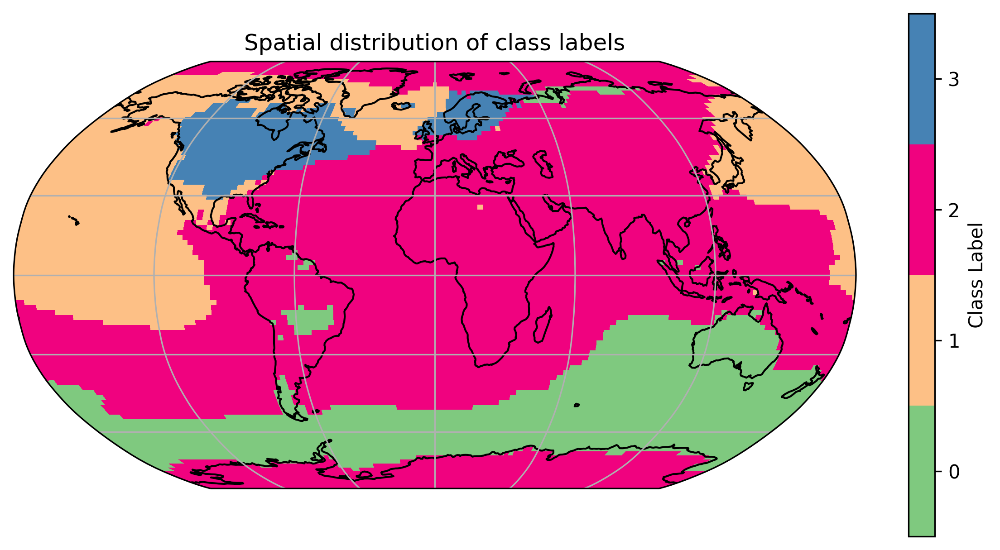

In [24]:

from toolbox import GMM_functions as gf
gf.plot_labels(ds_GMM_climo_relabeled,label_var_name='class_relabeled')
# gf.plot_labels(ds_GMM_climo_relabeled,label_var_name='class_label')

In [1]:
# load the ds_GMM_climo_relabeled
import xarray as xr
ds_GMM_climo_relabeled = xr.open_dataset('climo_ana_data/ds_GMM_climo_relabeled.nc')

# load the probs
import pickle
probs = pickle.load(open('climo_ana_data/probs.pkl', 'rb'))

0.5900992604595711
0.9905268644269519


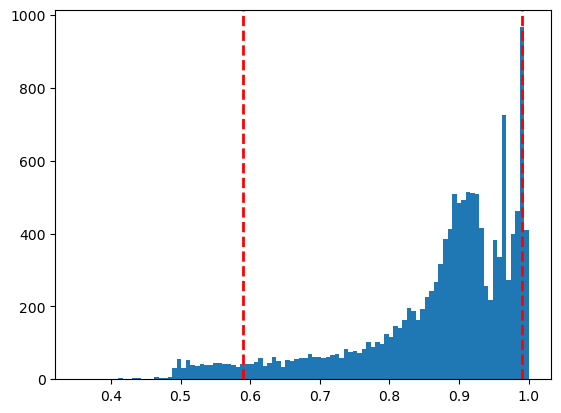

In [9]:
# plot a histogram of the probabilities
import matplotlib.pyplot as plt
plt.hist(probs.reshape(96*144,1), bins=100)
# plot vertical lines at 5th and 95th percentiles
plt.axvline(x=np.percentile(probs, 5), color='r', linestyle='dashed', linewidth=2)
print(np.percentile(probs, 5))
plt.axvline(x=np.percentile(probs, 95), color='r', linestyle='dashed', linewidth=2)
print(np.percentile(probs, 95))

# plot the class label, and its uncertainty

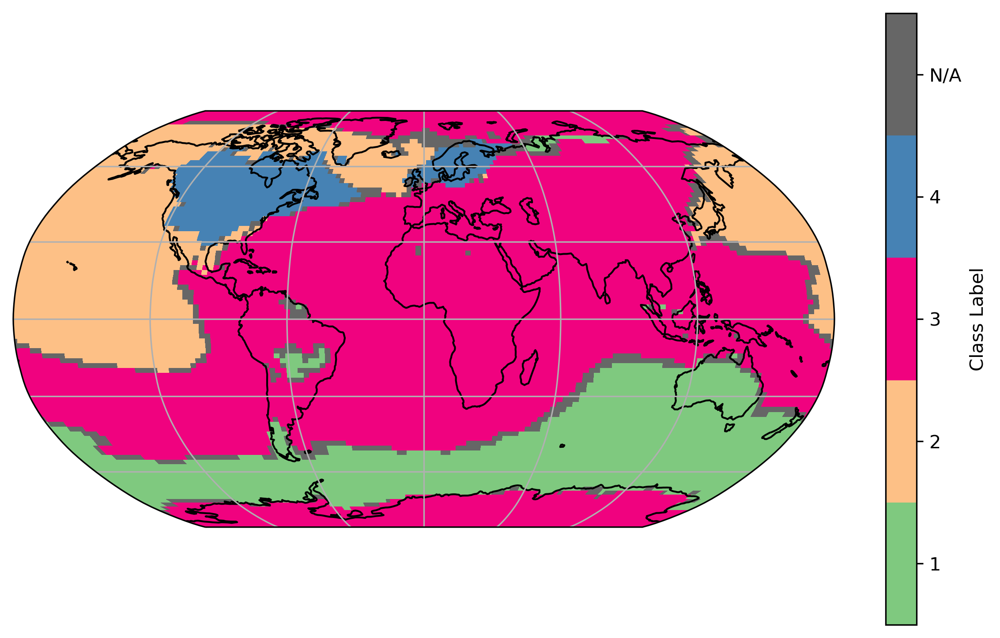

In [10]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import ListedColormap

class_labels = ds_GMM_climo_relabeled['class_relabeled'].values  # Ensure this is your class label data

n_components = 4
# Define a new class label for low probabilities
low_prob_label = n_components 

# Update class_labels for locations where prob < 0.9 to the new class
# class_labels_updated = np.where(probs < 0.9, low_prob_label, class_labels)

class_labels_updated = np.where(probs < 0.59, low_prob_label, class_labels)

# Custom colors including gray for low probability
custom_colors = [
    (0.4980392156862745, 0.788235294117647, 0.4980392156862745),
    (0.9921568627450981, 0.7529411764705882, 0.5254901960784314),
    (0.9411764705882353, 0.00784313725490196, 0.4980392156862745),
    (0.27450980392156865, 0.5098039215686274, 0.7058823529411765),
    (0.4, 0.4, 0.4)  # Gray for low prob
]
cmap = ListedColormap(custom_colors)

# Setup plot
fig, ax = plt.subplots(subplot_kw={'projection': ccrs.Robinson()}, figsize=(10, 6), dpi=300)
ax.add_feature(cfeature.COASTLINE)
ax.gridlines()

# Generating meshgrid for lon-lat with one additional point in each dimension
lon, lat = np.meshgrid(np.linspace(ds_GMM_climo_relabeled.lon.min(), ds_GMM_climo_relabeled.lon.max(), len(ds_GMM_climo_relabeled.lon)), 
                       np.linspace(ds_GMM_climo_relabeled.lat.min(), ds_GMM_climo_relabeled.lat.max(), len(ds_GMM_climo_relabeled.lat)))

# Plot using pcolormesh
pcolormesh = ax.pcolormesh(lon, lat, class_labels_updated, cmap=cmap, shading='auto', transform=ccrs.PlateCarree())

# Colorbar setup
bounds = np.arange(-0.5, len(custom_colors)+1 - 0.5, 1)
cbar = plt.colorbar(pcolormesh, boundaries=bounds, ticks=np.arange(len(custom_colors)), label='Class Label')
cbar.set_ticklabels(['1', '2', '3', '4', 'N/A'])  # Adjust labels as needed

plt.show()


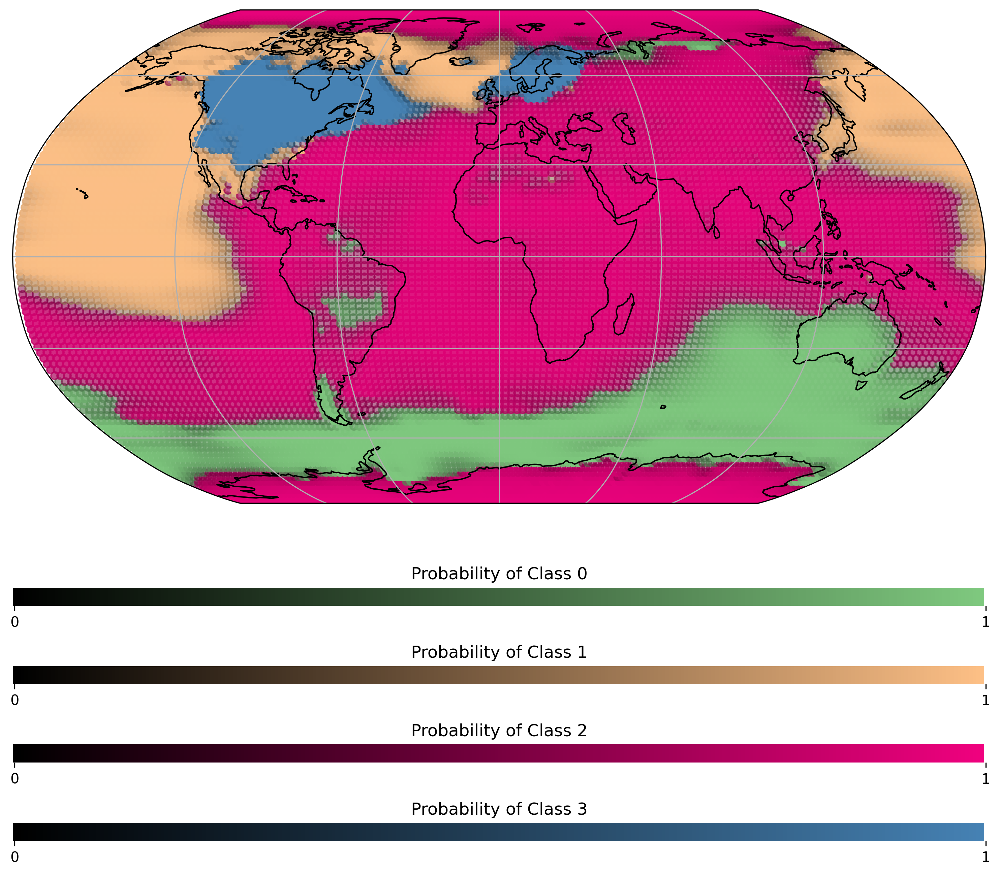

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches

def interpolate_color(original_color, prob):
    # Interpolate between black and the original color
    mixed_color = [prob * component for component in original_color]
    return mixed_color

def create_gradient_image(color):
    # Create a gradient from black to the given color
    gradient = np.linspace(0, 1, 256)
    return np.array([[interpolate_color(color, g) for g in gradient]])


n_components = 4
lat = ds_GMM_climo_relabeled['lat'].values
lon = ds_GMM_climo_relabeled['lon'].values
class_labels = ds_GMM_climo_relabeled['class_relabeled'].values

# Set up the grid layout
fig = plt.figure(figsize=(10, 9), dpi=300)
gs = gridspec.GridSpec(5, 1, height_ratios=[30, 1,1,1,1])

# Main plot for the map
ax = plt.subplot(gs[0], projection=ccrs.Robinson())
ax.add_feature(cfeature.COASTLINE)
ax.gridlines()

# Custom colormap
custom_colors = [
    (0.4980392156862745, 0.788235294117647, 0.4980392156862745),
    (0.9921568627450981, 0.7529411764705882, 0.5254901960784314),
    (0.9411764705882353, 0.00784313725490196, 0.4980392156862745),
    (0.27450980392156865, 0.5098039215686274, 0.7058823529411765),
]
cmap = ListedColormap(custom_colors)

# Loop through each grid point
for i in range(len(lat)):
    for j in range(len(lon)):
        class_index = class_labels[i, j]
        prob = probs[i, j]
        original_color = cmap(class_index / n_components)
        color = interpolate_color(original_color, prob)
        ax.scatter(lon[j], lat[i], color=color, transform=ccrs.PlateCarree(), s=30)

ax.set_global()
# class_patches = [mpatches.Patch(color=cmap(i/n_components), label=f'Class {i}') for i in range(n_components)]
# ax.legend(handles=class_patches, bbox_to_anchor=(1.05, 1), loc='upper left', title="Class Labels")

# Subplot for the color bar
for i in range(n_components):
    ax2 = plt.subplot(gs[i+1])
    # Create a gradient image
    gradient = np.linspace(0, 1, 256)[np.newaxis, :]
    # ax2.imshow(gradient, aspect='auto', cmap='Greys')
    gradient_image = create_gradient_image(custom_colors[i])
    # ax2.imshow(gradient, aspect='auto', cmap=ListedColormap(gradient_images))
    ax2.imshow(gradient_image, aspect='auto')
    # set spines invisible
    ax2.spines['top'].set_visible(False)
    ax2.spines['right'].set_visible(False)
    ax2.spines['bottom'].set_visible(False)
    ax2.spines['left'].set_visible(False)

    ax2.set_yticks([])
    ax2.set_xticks([0, 256])
    ax2.set_xticklabels(['0', '1'])
    ax2.set_title(f'Probability of Class {i}')

# Adjust layout
plt.tight_layout()

plt.show()


Class 0 Median Probability: 0.9529776016226197
Class 1 Median Probability: 0.9593866824949556
Class 2 Median Probability: 0.8881100657410352
Class 3 Median Probability: 0.9995718081940829


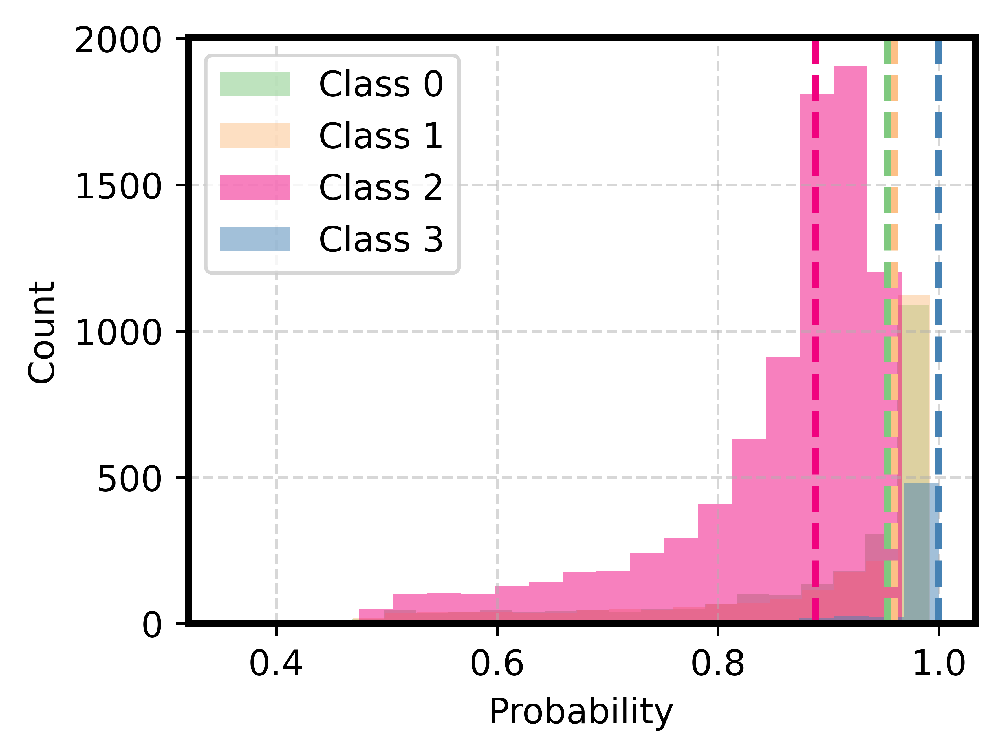

In [79]:
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
import numpy as np


n_components = 4

custom_colors = [
(0.4980392156862745, 0.788235294117647, 0.4980392156862745),
(0.9921568627450981, 0.7529411764705882, 0.5254901960784314),
(0.9411764705882353, 0.00784313725490196, 0.4980392156862745),
(0.27450980392156865, 0.5098039215686274, 0.7058823529411765),]

# Create a ListedColormap object with your custom colors
cmap = ListedColormap(custom_colors)  

# Create a figure for the histogram
plt.figure(figsize=(4, 3),dpi=900)

# Plot histogram for each class
for i in range(n_components):
    class_probs = probs[ds_GMM_climo_relabeled['class_relabeled'].values == i]
    plt.hist(class_probs, bins=20, alpha=0.5, label=f'Class {i}',facecolor=custom_colors[i])
    # plot the median of each class
    plt.axvline(np.median(class_probs), color=custom_colors[i], linestyle='--', linewidth=2)
    print(f"Class {i} Median Probability:", np.median(class_probs))
    

plt.xlabel('Probability')
plt.ylabel('Count')
# plt.title('Histogram of Probabilities for Each Class')
plt.grid(True,linestyle='--',alpha=0.5)
# set the linewidth of spine to 2
plt.rcParams['axes.linewidth']=2
plt.legend()
plt.show()



# Plot average curves

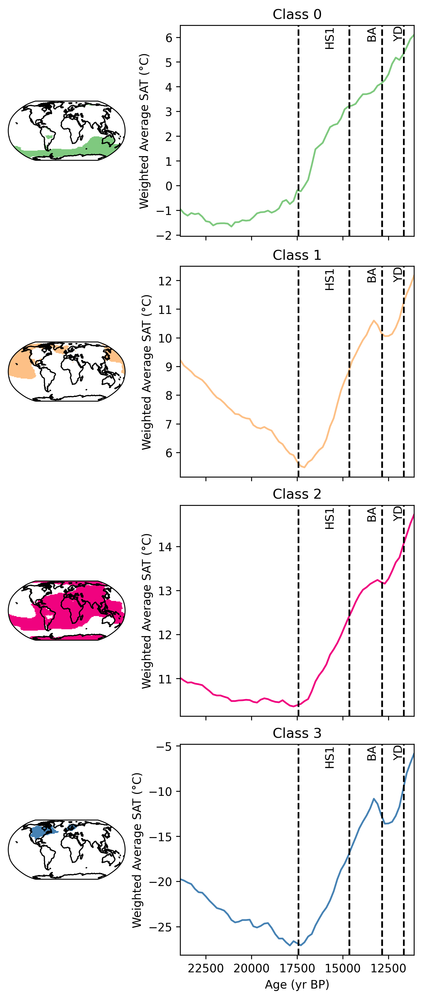

In [25]:
from toolbox import GMM_functions as gfs
uncor_weighted_avg=gfs.plot_weighted_average_curve(ds_GMM_climo_relabeled.copy(),label_var_name='class_relabeled', dpi=300)

# Relabel the average curves

In [26]:
from toolbox import change_point_functions as cpf
ds_GMM_climo_relabeled=cpf.cal_anomalies(ds_GMM_climo_relabeled,2000)

relabeled_weighted_avg = {}
for i in range(4):
    relabeled_weighted_avg[i] = cpf.cal_weighted_average_curve(ds_GMM_climo_relabeled, i, sat_var_name='sat_anomalies',class_label_name='class_relabeled')

In [28]:
# save the relabeled_weighted_avg
import pickle
pickle.dump(relabeled_weighted_avg, open('climo_ana_data/relabeled_weighted_avg.pkl', 'wb'))


In [29]:
# read the relabeled_weighted_avg
import pickle
relabeled_weighted_avg = pickle.load(open('climo_ana_data/relabeled_weighted_avg.pkl', 'rb'))

-Progress:100.0% done[==============================================================]
pospr_diff_max_index: 13
cps [15. 28. 32. 37. 45.]
selected_cp_index: 0
\Progress:100.0% done[==============================================================]
pospr_diff_max_index: 34
cps [16. 23. 34. 40. 48.]
selected_cp_index: 2
|Progress:100.0% done[==============================================================]
pospr_diff_max_index: 34
cps [16. 29. 35. 51.]
selected_cp_index: 2
/Progress:100.0% done[==============================================================]
pospr_diff_max_index: 34
cps [17. 26. 35. 43. 49.]
selected_cp_index: 2


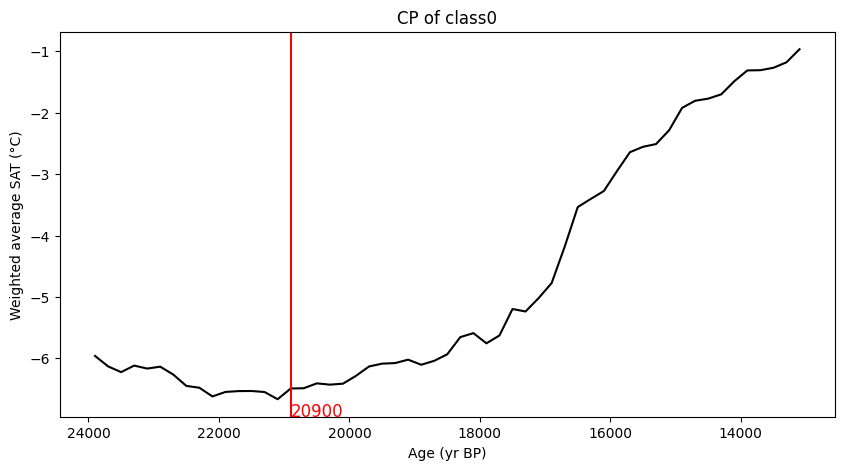

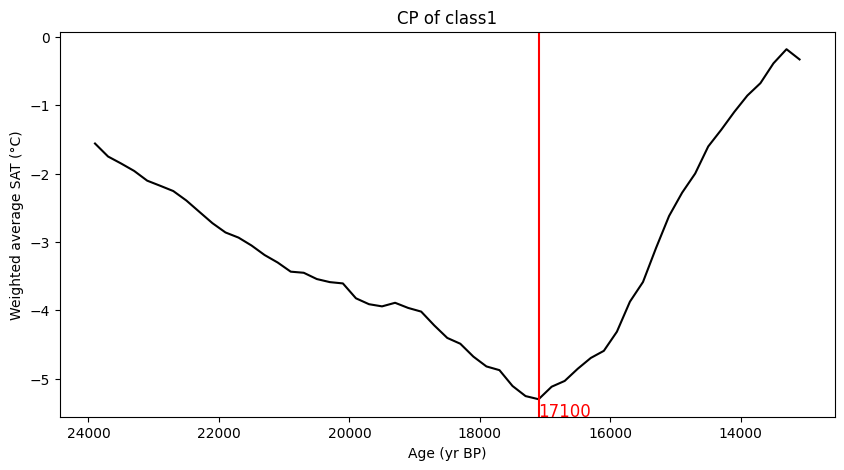

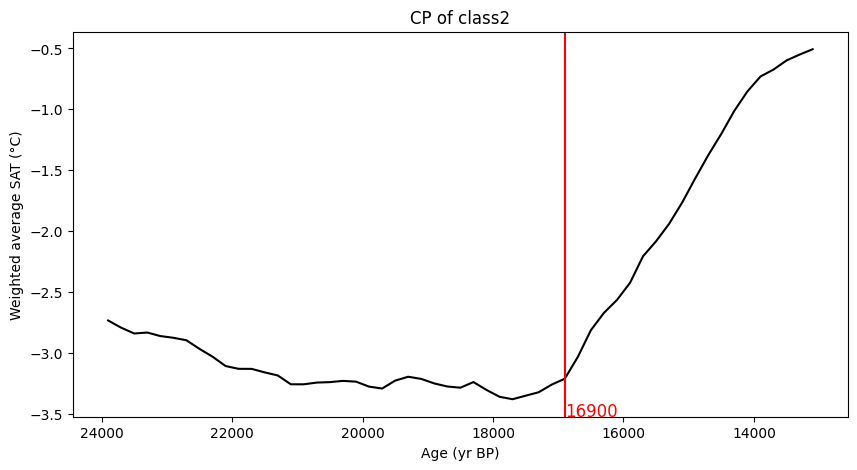

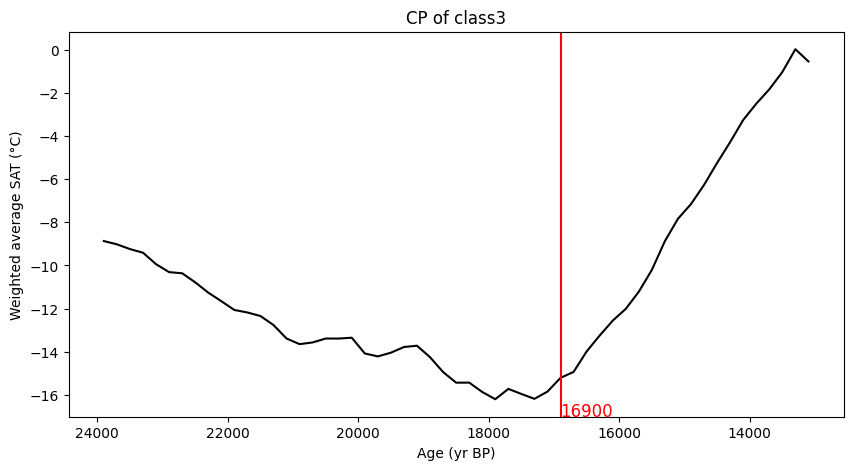

In [27]:
from toolbox import change_point_functions as cpf

for i in range(len(relabeled_weighted_avg)):
    cp_climo_info_relabeled=cpf.find_cp(relabeled_weighted_avg[i], ds_GMM_climo_relabeled['age'].values, avg_plot=True, avg_plot_title=f'CP of class{i}')

# Testing the scenario where K!=4

In [3]:
# load EOFs
import pickle
eofs_climo = pickle.load(open('climo_ana_data/eofs_climo.pkl', 'rb'))


import xarray as xr
ds_sat = xr.open_dataset('data/LGMR_SAT_climo.nc')
ds_sat = ds_sat.where(ds_sat.age>=14000, drop=True)


c:\Users\zps19\.conda\envs\pz-env\lib\site-packages\xarray\coding\variables.py:148: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  condition |= data == fv


In [8]:
eofs_climo.shape

(13824, 2)

In [7]:
ds_sat.info

<bound method Dataset.info of <xarray.Dataset>
Dimensions:  (age: 50, lat: 96, lon: 144)
Coordinates:
  * lat      (lat) float32 -90.0 -88.11 -86.21 -84.32 ... 84.32 86.21 88.11 90.0
  * lon      (lon) float32 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5
  * age      (age) float32 1.41e+04 1.43e+04 1.45e+04 ... 2.37e+04 2.39e+04
Data variables:
    sat      (age, lat, lon) float32 -52.92 -52.9 -52.92 ... -41.98 -41.98
    sat_std  (age, lat, lon) float32 0.9079 0.9112 0.9097 ... 3.529 3.533 3.536>

In [4]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture



# Perform GMM on eofs with number of classes varying from 2 to 10
n_classes_list = range(2, 11)
gmm_results = []

for n_classes in n_classes_list:
    gmm_model = GaussianMixture(n_components=n_classes, covariance_type='full')
    gmm_model.fit(eofs_climo)
    class_labels = gmm_model.predict(eofs_climo)

    # Reshape the class labels and store in the dataset
    ds_sat_copy = ds_sat.copy()
    sat_shape = ds_sat['sat'].shape
    ds_sat_copy['class_label'] = (('lat', 'lon'), class_labels.reshape(sat_shape[1], sat_shape[2]))
    gmm_results.append(ds_sat_copy)




In [6]:
# save the gmm_results
import pickle
pickle.dump(gmm_results, open('climo_ana_data/gmm_results.pkl', 'wb'))

In [ ]:
# load the gmm_results
import pickle
gmm_results = pickle.load(open('climo_ana_data/gmm_results.pkl', 'rb'))

In [62]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.gridspec as gridspec
from matplotlib.colors import ListedColormap

custom_colors = [
    (0.4980392156862745, 0.788235294117647, 0.4980392156862745),
    (0.9921568627450981, 0.7529411764705882, 0.5254901960784314),
    (0.9411764705882353, 0.00784313725490196, 0.4980392156862745),
    (0.27450980392156865, 0.5098039215686274, 0.7058823529411765),
    (0.7450980392156863, 0.6823529411764706, 0.8313725490196079),
    (1.0, 1.0, 0.6),
    (0.2196078431372549, 0.2235294117647059, 0.901960784313725),
    (0.7490196078431373, 0.3568627450980392, 0.09019607843137253),
    (1/255, 50/255, 32/255),
    (1, 0, 1)
]
cmap = ListedColormap(custom_colors)

label_mapping=[{0:2,1:3},{0:2,1:1,2:3},{2:0, 3:1, 0:3, 1:2},{1:2,2:1,3:0,4:3,0:4},{0:0,1:4,2:2,3:5,4:3,5:1},
               {0:4,1:2,2:1,3:0,4:6,5:5,6:3},{0:0,1:2,2:3,3:1,4:5,5:4,6:6,7:7},{0:8,1:1,2:0,3:2,4:5,5:3,6:4,7:6,8:7},
               {0:8,1:1,2:7,3:3,4:5,5:4,6:9,7:2,8:6,9:0}]
# Plot the spatial distribution of class labels
fig = plt.figure(figsize=(15, 10), dpi=900)
gs = gridspec.GridSpec(3, 4, width_ratios=[1, 1, 1, 0.05], figure=fig)  # The last column for colorbar

for idx, ds in enumerate(gmm_results):
    print(idx)
    n_classes = n_classes_list[idx]
    sat_label = ds['class_label']
    unique_labels = np.unique(sat_label)

    # if label_mapping[idx] is not None, then relabel the class labels
    if idx<=8:
        if label_mapping[idx] is not None:
            # Convert the class_label data into a numpy array to work with it directly
            original_class_labels = sat_label.values

            # Create a new array for relabeled class labels based on the match dictionary
            relabeled_class_labels = np.vectorize(label_mapping[idx].get)(original_class_labels)

            # Add the new relabeled class labels as a data variable to the dataset
            ds['class_label_relabeled'] = (('lat', 'lon'), relabeled_class_labels)
            sat_label = ds['class_label_relabeled']

    # Create a custom colormap for each subplot based on the number of unique classes
    if idx==0:
        cmap_subset = ListedColormap(custom_colors[2:4])
    elif idx==1:
        cmap_subset = ListedColormap(custom_colors[1:4])
        
    else:
        cmap_subset = ListedColormap(custom_colors[:len(unique_labels)])

    ax = plt.subplot(gs[idx // 3, idx % 3], projection=ccrs.Robinson())
    ax.add_feature(cfeature.COASTLINE)
    ax.gridlines()

    # Plot using the custom colormap
    im = sat_label.plot(ax=ax, transform=ccrs.PlateCarree(), cmap=cmap_subset, shading='auto', add_colorbar=False)

    ax.set_global()
    ax.set_title(f'K = {n_classes}')

    # Add colorbar for each subplot
    # plt.colorbar(im, ax=ax, orientation='vertical', fraction=0.046, pad=0.04)

# Add colorbar in the space reserved for it
cbar = plt.colorbar(im, cax=plt.subplot(gs[:, -1]), orientation='vertical')
# cbar.ax.set_yticklabels(np.arange(n_classes))
cbar.ax.set_yticklabels(['1', '2', '3', '4', '5', '6', '7', '8', '9', '10'])
cbar.ax.set_ylabel('Class Label')

plt.tight_layout()
plt.show()


0
1
2
3
4
5
6
7
8


C:\Users\zps19\AppData\Local\Temp\ipykernel_9372\1730322561.py:73: UserWarning: FixedFormatter should only be used together with FixedLocator
  cbar.ax.set_yticklabels(['1', '2', '3', '4', '5', '6', '7', '8', '9', '10'])


# GMM on the sklearn PCA results

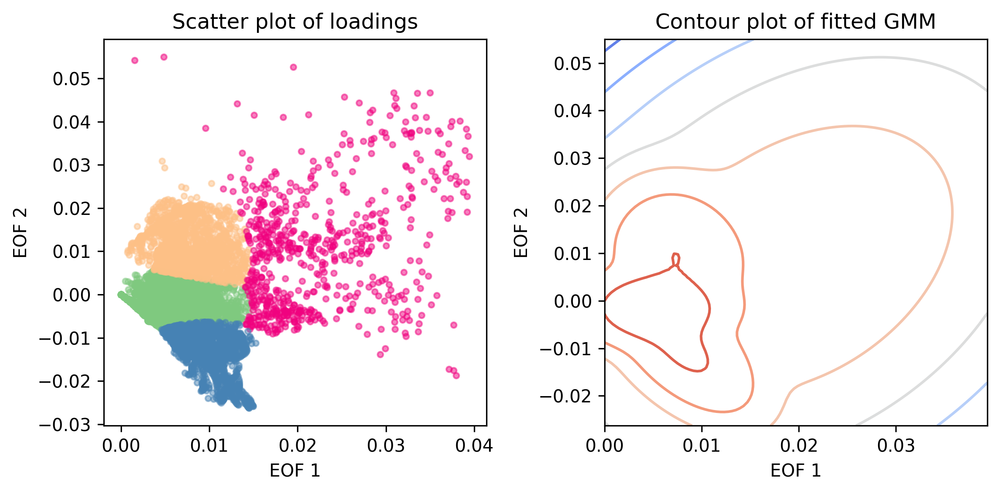

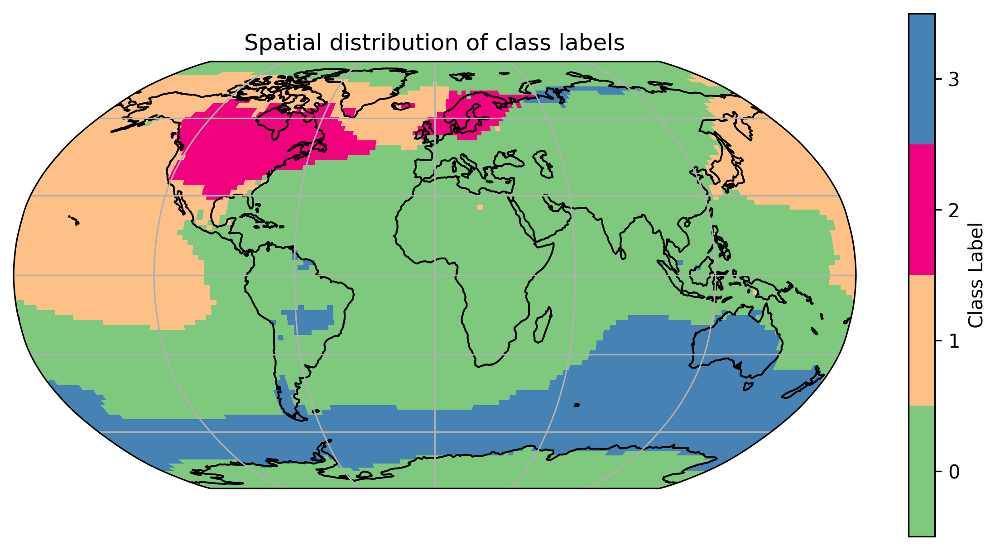

In [31]:
from toolbox import GMM_functions as gf
ds_EOFs_GMM=gf.GMM4EOFS(eofs_climo_sk, ds_sat,n_components=4)
gf.plot_labels(ds_EOFs_GMM)